# Setting up

In [1]:
from utils import *

In [3]:
# Setting a random
np.random.seed(42)

# Define the image dimensions
IMG_W, IMG_H, IMG_C = (160, 160, 3)

# Data Loading

In [4]:
# Specify the root directory path
root_path = 'D:/Face recognition/VN-celeb/'

# Collect all the person names
dir_names = os.listdir(root_path)
person_names = [name for name in dir_names]
n_individuals = len(person_names)

print(f"Total number of individuals: {n_individuals}\n")
# print(f"Name of the individuals : \n\t{person_names}")

Total number of individuals: 1020



In [6]:
trainpaths, testpaths = get_train_test_split(root_path)
len(trainpaths), len(testpaths)

Train test split:   0%|          | 0/1020 [00:00<?, ?it/s]

Train test split: 100%|██████████| 1020/1020 [00:00<00:00, 3506.92it/s]


(18902, 4203)

In [7]:
# Number of images available per person
n_images_per_person = [len(os.listdir(root_path + name)) for name in dir_names]
n_images = sum(n_images_per_person)

# Show
print(f"Total Number of Images : {n_images}.")

Total Number of Images : 23105.


In [8]:
# Create space for test set
np.random.shuffle(testpaths)

# Create space for the images
all_images = np.empty(shape=(len(testpaths), IMG_W, IMG_H, IMG_C), dtype = np.float32)
all_labels = np.empty(shape=(len(testpaths), 1), dtype = np.int32)

# For each path, load the image and apply some preprocessing.
for index, path in tqdm(enumerate(testpaths), desc="Loading Data",
                       total=len(testpaths)):
    
    # Extract label
    label = re.findall(r'VN-celeb/(\d+)/', path)[0]
    label = person_names.index(label)
    
    # Load the Image
    image = plt.imread(path)
    
    # Resize the image
    image = cv.resize(image, dsize = (IMG_W, IMG_H))
    
    # Convert image stype
    image = image.astype(np.float32)
    
    # Store the image and the label
    all_images[index] = image
    all_labels[index] = label

Loading Data:   0%|          | 0/4203 [00:00<?, ?it/s]

Loading Data: 100%|██████████| 4203/4203 [01:03<00:00, 66.48it/s] 


# Data visualization

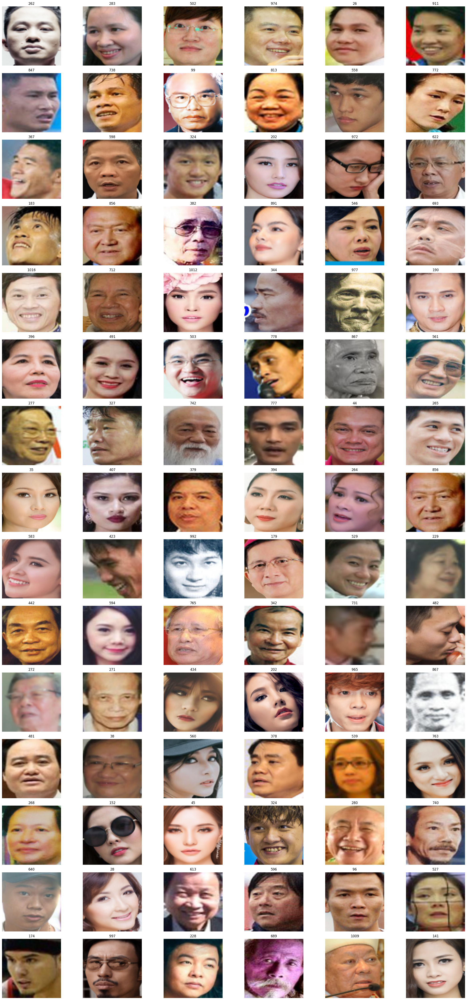

In [10]:
show_data(images = all_images, labels = all_labels, person_names=person_names)

# Image embeddings

For generating these **embeddings**, we first need to load the **FaceNet** model.

In [12]:
# Load model
model = load_model('D:/Face recognition/model/facenet-keras/facenet_keras.h5')

In [13]:
# Select all the file paths : 10 images per person.
filepaths = [np.random.choice(glob(root_path + name + '/*'), size=10) for name in dir_names if glob(root_path + name + '/*') not in testpaths]

# # Create data base
database = {name:generate_avg_embedding(paths, model=model) for paths, name in tqdm(zip(filepaths, person_names), desc="Generating Embeddings",
                                                                                   total=len(filepaths))}

Generating Embeddings: 100%|██████████| 1020/1020 [55:54<00:00,  3.29s/it]


# Face Recognition

Let's have a quick look at the functioning of the function.

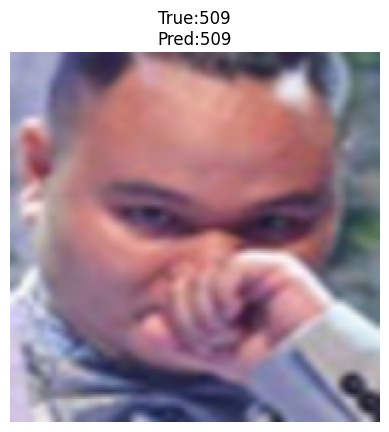

In [18]:
# Randomly select an index
index = np.random.randint(len(all_images))

# Obtain an image and its corresponding label
image_ = all_images[index]
label_ = person_names[int(all_labels[index])]

# Recognize the face in the image
title = recognize_face(image_, database)

# Plot the image along with its true and predicted labels
plt.imshow(image_)
plt.title(f"True:{label_}\nPred:{title}")
plt.axis('off')
plt.show()

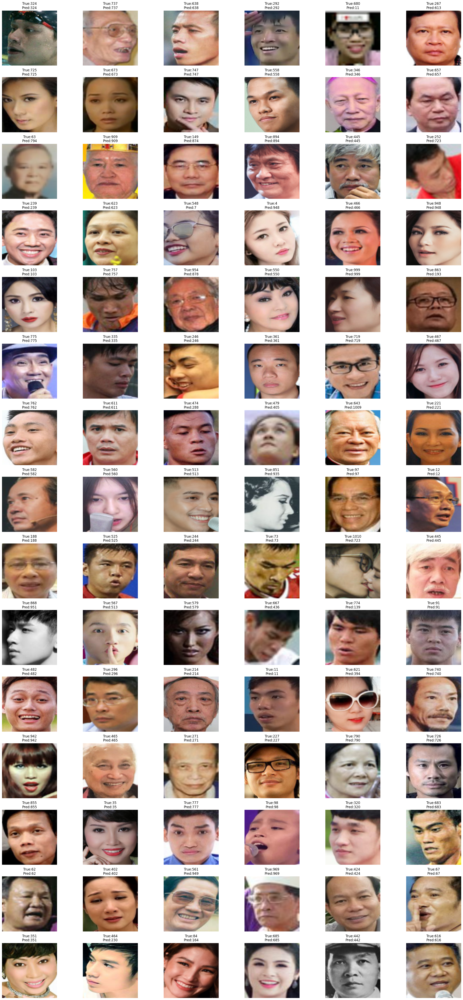

In [19]:
show_data(all_images, all_labels, recog_fn = recognize_face, database = database, person_names=person_names)

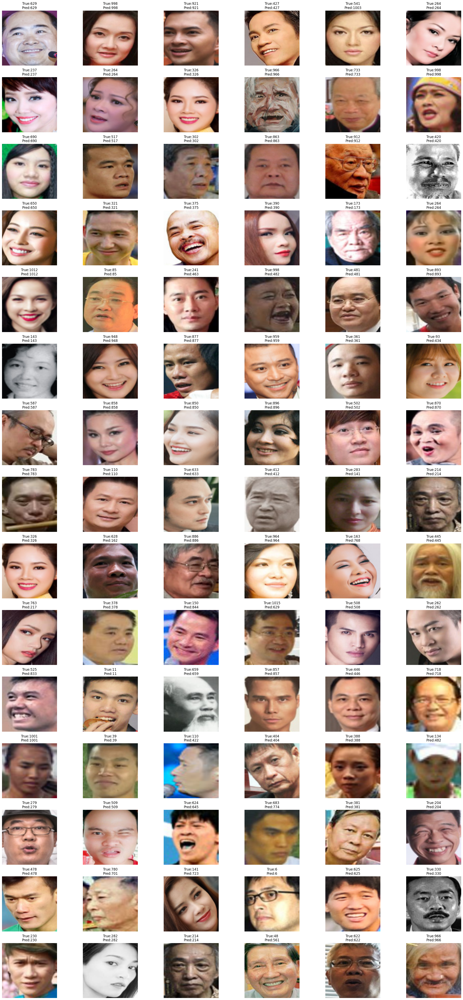

In [20]:
show_data(all_images, all_labels, recog_fn = recognize_face, database = database, person_names=person_names)

### Accuracy

In [22]:


# Initialize the number of correct predictions
n_correct = 0

# Iterate over each image and its corresponding label
for (image, label) in tqdm(zip(all_images,all_labels), total=len(all_images)):
    
    # Extract the true label of the person in the image
    true_label = person_names[int(label)]

    # Use the recognize_face function to predict the label of the person in the image
    pred_label = recognize_face(image, database)

    # If the true label and the predicted label match, increment the number of correct predictions
    if true_label == pred_label:
        n_correct += 1

# Calculate the accuracy of the model
acc = (n_correct / len(all_images)) * 100.0

# Print the accuracy of the model
print(f"Model Accuracy: {acc}%!!!")

100%|██████████| 4203/4203 [1:19:52<00:00,  1.14s/it]

Model Accuracy: 80.39495598382108%!!!


## Larger train data

In [15]:
# Select all the file paths : 50 images per person.
filepaths = [np.random.choice(glob(root_path + name + '/*'), size=25) for name in dir_names if glob(root_path + name + '/*') not in testpaths]

# Create data base
large_database = {name:generate_avg_embedding(paths, model=model) for paths, name in tqdm(zip(filepaths, person_names), desc="Generating Embeddings",
                                                                                   total=len(filepaths))}

Generating Embeddings: 100%|██████████| 1020/1020 [11:19:42<00:00, 39.98s/it]


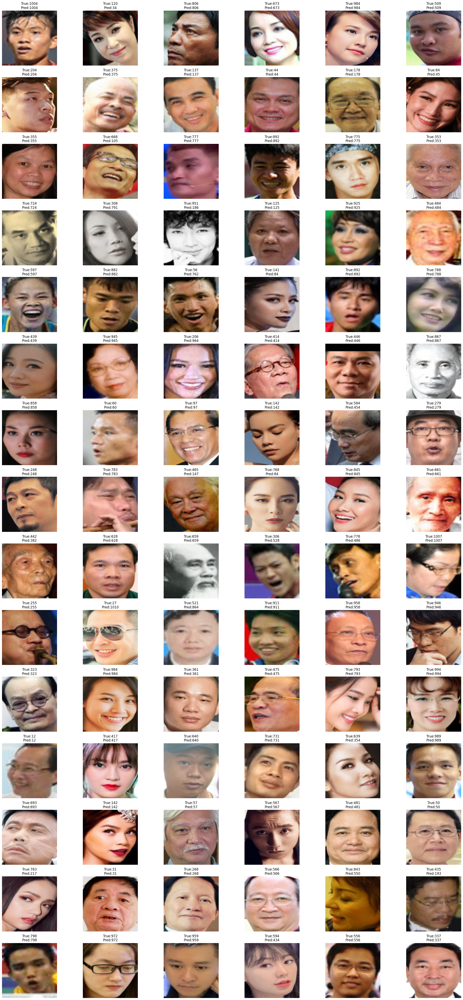

In [16]:
show_data(all_images, all_labels, recog_fn = recognize_face, database = large_database, person_names=person_names)

In [19]:
# # Initialize the number of correct predictions
n_correct = 0


# Iterate over each image and its corresponding label
for (image, label) in tqdm(zip(all_images,all_labels), total=len(all_images)):
    
    # Extract the true label of the person in the image
    true_label = person_names[int(label)]

    # Use the recognize_face function to predict the label of the person in the image
    pred_label = recognize_face(image, large_database)

    # If the true label and the predicted label match, increment the number of correct predictions
    if true_label == pred_label:
        n_correct += 1

# Calculate the accuracy of the model
acc = (n_correct / len(all_images)) * 100.0

# Print the accuracy of the model
print(f"Model Accuracy: {acc}%!!!")

100%|██████████| 4203/4203 [3:26:49<00:00,  2.95s/it]

Model Accuracy: 83.20247442303116%!!!
